In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns 
%matplotlib inline
import math
from sklearn.preprocessing import Normalizer, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import OneHotEncoder
from scipy import stats 
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report


In [2]:
df2_clean = pd.read_csv('/Users/sarahrestrepo/Desktop/Ironhack/Python_project/df2_clean_LM.csv')

In [3]:
df2_clean.head()

,Unnamed: 0,name,age,ova,club,position,bmi,height_inches,new_weight,attacking,skill,movement,power,mentality,defending,total_stats
0,0,G. Pasquale,33,69,Udinese,LM,24.545332,72,181,313,338,347,347,320,208,1929
1,1,Luis García,37,71,KAS Eupen,CM CAM CDM,20.516122,70,143,337,369,305,324,362,153,1906
2,2,J. Cole,33,71,Coventry City,CAM RM RW LM,23.772947,69,161,337,387,295,284,317,99,1770
3,3,D. Odonkor,27,66,Alemannia Aachen,RW RM,24.781358,68,163,271,276,406,315,256,79,1649
4,4,G. Neville B,35,76,Manchester United,RB CB RWB,24.963673,70,174,304,258,324,284,319,242,1774


In [4]:
df2_clean = df2_clean.drop(['Unnamed: 0'], axis = 1)

In [5]:
df2_clean.head()

,name,age,ova,club,position,bmi,height_inches,new_weight,attacking,skill,movement,power,mentality,defending,total_stats
0,G. Pasquale,33,69,Udinese,LM,24.545332,72,181,313,338,347,347,320,208,1929
1,Luis García,37,71,KAS Eupen,CM CAM CDM,20.516122,70,143,337,369,305,324,362,153,1906
2,J. Cole,33,71,Coventry City,CAM RM RW LM,23.772947,69,161,337,387,295,284,317,99,1770
3,D. Odonkor,27,66,Alemannia Aachen,RW RM,24.781358,68,163,271,276,406,315,256,79,1649
4,G. Neville B,35,76,Manchester United,RB CB RWB,24.963673,70,174,304,258,324,284,319,242,1774


In [6]:
df2_clean.dtypes

name              object
age                int64
ova                int64
club              object
position          object
bmi              float64
height_inches      int64
new_weight         int64
attacking          int64
skill              int64
movement           int64
power              int64
mentality          int64
defending          int64
total_stats        int64
dtype: object

In [7]:
df2_clean.isna().sum()

name             0
age              0
ova              0
club             0
position         0
bmi              0
height_inches    0
new_weight       0
attacking        0
skill            0
movement         0
power            0
mentality        0
defending        0
total_stats      0
dtype: int64

In [8]:
df2_clean = df2_clean.drop_duplicates()

In [9]:
df2_clean = df2_clean.reset_index(drop=True)

<AxesSubplot:xlabel='bmi'>

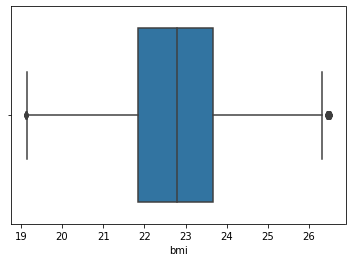

In [10]:
sns.boxplot(x = df2_clean['bmi']) #outliers have been removed

In [11]:
df2_clean['bmi'].describe()

count    14158.000000
mean        22.786408
std          1.314385
min         19.120949
25%         21.853392
50%         22.782407
75%         23.672449
max         26.515857
Name: bmi, dtype: float64

In [12]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np

<AxesSubplot:ylabel='Density'>

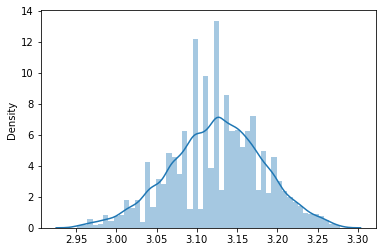

In [13]:
bmi_lt = list(map(  log_transform, df2_clean['bmi']))
sns.distplot(bmi_lt)

<AxesSubplot:xlabel='age'>

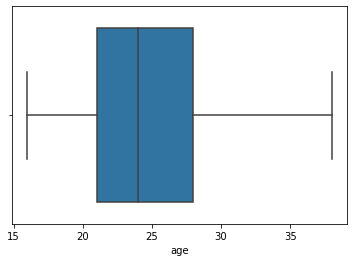

In [14]:
sns.boxplot(x = df2_clean['age']) #outliers have been removed

In [15]:
df2_clean['age'].describe()

count    14158.000000
mean        24.786340
std          4.532715
min         16.000000
25%         21.000000
50%         24.000000
75%         28.000000
max         38.000000
Name: age, dtype: float64

In [16]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

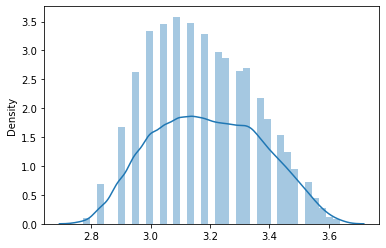

In [17]:
age_lt = list(map(log_transform, df2_clean['age']))
sns.distplot(age_lt)

<AxesSubplot:xlabel='ova'>

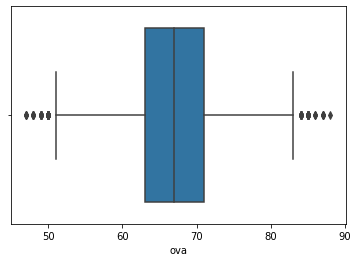

In [18]:
sns.boxplot(x = df2_clean['ova'])

<AxesSubplot:xlabel='height_inches'>

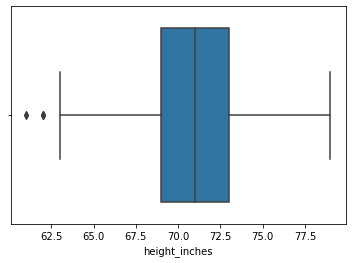

In [19]:
sns.boxplot(x = df2_clean['height_inches'])

<AxesSubplot:xlabel='new_weight'>

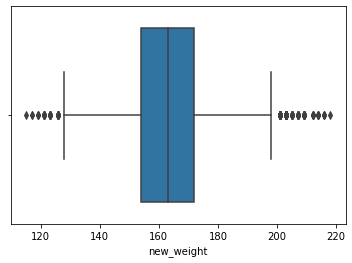

In [20]:
sns.boxplot(x = df2_clean['new_weight'])

In [21]:
xnew_weight = np.percentile(df2_clean['new_weight'], 75)
xnew_weight1 = np.percentile(df2_clean['new_weight'], 25)
print(xnew_weight)
print(xnew_weight1)
iqr = xnew_weight - xnew_weight1
print(iqr)
upper_limit = xnew_weight + 2*iqr
print(upper_limit)
lower_limit = xnew_weight1 - 2*iqr
print(lower_limit)

172.0
154.0
18.0
208.0
118.0


In [22]:
df2_clean = df2_clean[(df2_clean['new_weight']<upper_limit) & (df2_clean['new_weight']>lower_limit)]

<AxesSubplot:xlabel='new_weight'>

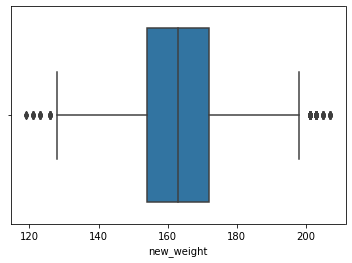

In [23]:
sns.boxplot(x = df2_clean['new_weight'])

<AxesSubplot:xlabel='attacking'>

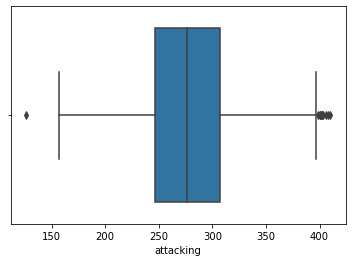

In [24]:
sns.boxplot(x = df2_clean['attacking']) #outliers have been removed

In [25]:
df2_clean['attacking'].describe()

count    14126.000000
mean       275.978621
std         43.238239
min        126.000000
25%        246.000000
50%        276.000000
75%        307.000000
max        410.000000
Name: attacking, dtype: float64

<AxesSubplot:ylabel='Density'>

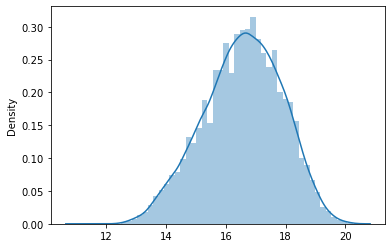

In [26]:
attack_pt = list(map(lambda x: math.sqrt(x), df2_clean['attacking']))
sns.distplot(attack_pt)

<AxesSubplot:xlabel='skill'>

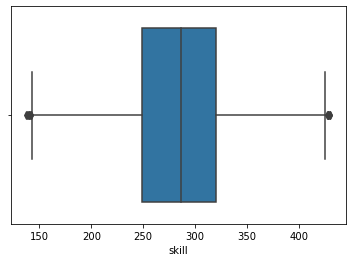

In [27]:
sns.boxplot(x = df2_clean['skill']) #outliers have been removed

In [28]:
df2_clean['skill'].describe()

count    14126.000000
mean       284.170749
std         50.742650
min        137.000000
25%        249.000000
50%        286.000000
75%        320.000000
max        430.000000
Name: skill, dtype: float64

<AxesSubplot:ylabel='Density'>

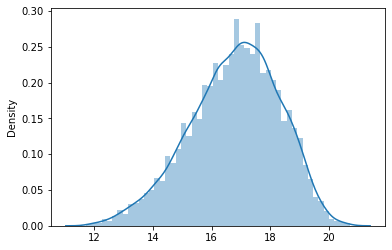

In [29]:
skill_pt = list(map(lambda x: math.sqrt(x), df2_clean['skill']))
sns.distplot(skill_pt)

<AxesSubplot:xlabel='movement'>

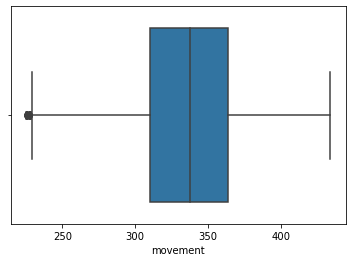

In [30]:
sns.boxplot(x = df2_clean['movement'])

In [31]:
df2_clean['movement'].describe()

count    14126.000000
mean       335.956888
std         39.659468
min        225.000000
25%        310.000000
50%        338.000000
75%        364.000000
max        434.000000
Name: movement, dtype: float64

In [32]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

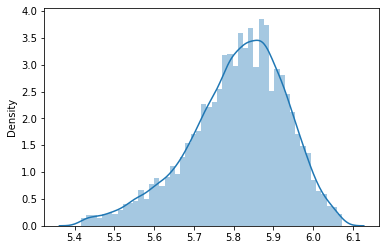

In [33]:
move_lt = list(map(log_transform, df2_clean['movement']))
sns.distplot(move_lt)

<AxesSubplot:xlabel='power'>

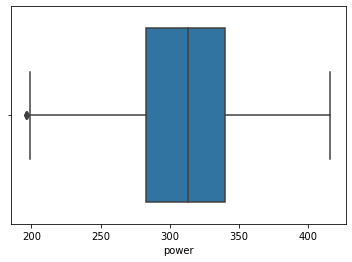

In [34]:
sns.boxplot(x = df2_clean['power'])

In [35]:
df2_clean['power'].describe()

count    14126.000000
mean       311.345250
std         38.722442
min        196.000000
25%        283.000000
50%        313.000000
75%        340.000000
max        416.000000
Name: power, dtype: float64

In [36]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

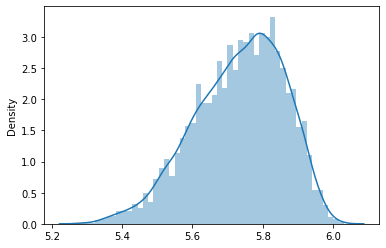

In [37]:
power_lt = list(map(log_transform, df2_clean['power']))
sns.distplot(power_lt)

<AxesSubplot:xlabel='mentality'>

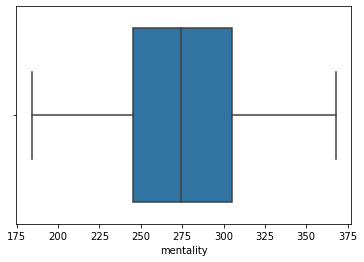

In [38]:
sns.boxplot(x = df2_clean['mentality'])

In [39]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

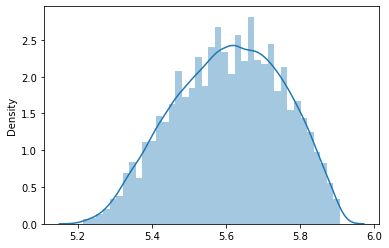

In [40]:
ment_lt = list(map(log_transform, df2_clean['mentality']))
sns.distplot(ment_lt)

<AxesSubplot:xlabel='defending'>

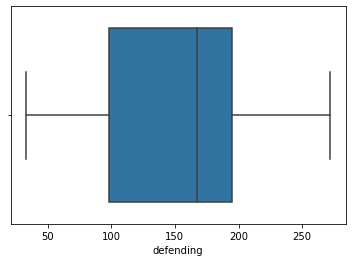

In [41]:
sns.boxplot(x = df2_clean['defending'])

<AxesSubplot:xlabel='total_stats'>

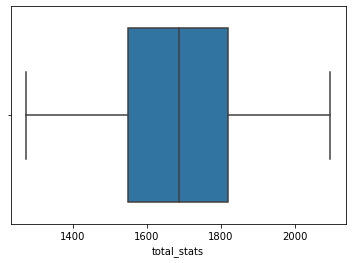

In [42]:
sns.boxplot(x = df2_clean['total_stats'])

In [43]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

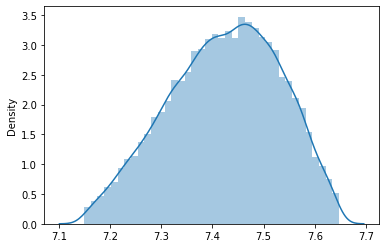

In [44]:
stats_lt = list(map(log_transform, df2_clean['total_stats']))
sns.distplot(stats_lt)

In [45]:
df2_clean = df2_clean.reset_index(drop=True)

In [46]:
df2_clean.isna().sum()

name             0
age              0
ova              0
club             0
position         0
bmi              0
height_inches    0
new_weight       0
attacking        0
skill            0
movement         0
power            0
mentality        0
defending        0
total_stats      0
dtype: int64

<AxesSubplot:>

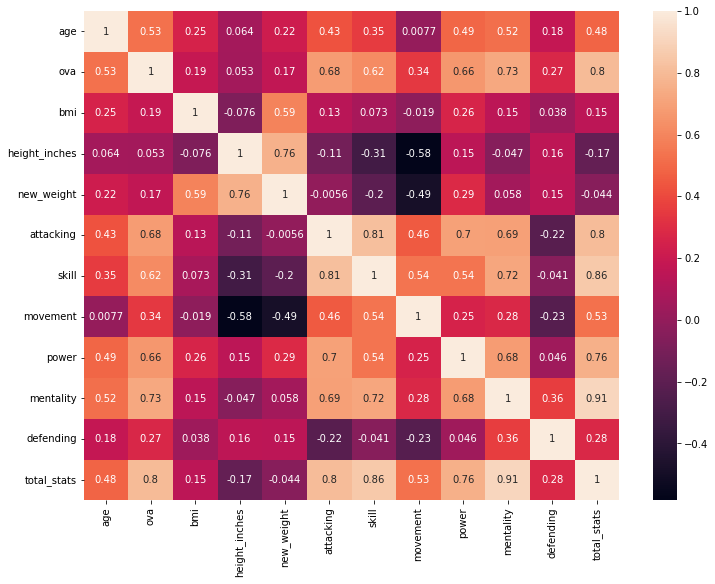

In [47]:
numericals = df2_clean.select_dtypes(np.number)
plt.figure(figsize=(12, 9))
corr_matrix = numericals.corr()
sns.heatmap(corr_matrix, annot=True)

In [48]:
categoricals = df2_clean.select_dtypes(np.object)
categoricals

,name,club,position
0,G. Pasquale,Udinese,LM
1,Luis García,KAS Eupen,CM CAM CDM
2,J. Cole,Coventry City,CAM RM RW LM
3,D. Odonkor,Alemannia Aachen,RW RM
4,G. Neville B,Manchester United,RB CB RWB
...,...,...,...
14121,R. Shanley,Hibernian,ST
14122,W. Rickard,Burnley,CAM CM
14123,C. Barrett,Burnley,RB
14124,J. Gazibegović,SK Sturm Graz,RB LB


In [49]:
y = df2_clean['ova']
features = df2_clean.drop(['ova'], axis=1)

In [50]:
numerical_features = features.select_dtypes(np.number)
categorical_features = features.select_dtypes(np.object)

In [51]:
numerical_features.head()

,age,bmi,height_inches,new_weight,attacking,skill,movement,power,mentality,defending,total_stats
0,33,24.545332,72,181,313,338,347,347,320,208,1929
1,37,20.516122,70,143,337,369,305,324,362,153,1906
2,33,23.772947,69,161,337,387,295,284,317,99,1770
3,27,24.781358,68,163,271,276,406,315,256,79,1649
4,35,24.963673,70,174,304,258,324,284,319,242,1774


In [52]:
scaled = Normalizer().fit_transform(numerical_features)
scaled = pd.DataFrame(scaled)
scaled.head()

,0,1,2,3,4,5,6,7,8,9,10
0,0.015805,0.011756,0.034484,0.086690,0.149911,0.161884,0.166195,0.166195,0.153263,0.099621,0.923890
1,0.017922,0.009938,0.033907,0.069266,0.163236,0.178736,0.147736,0.156939,0.175345,0.074110,0.923226
2,0.017141,0.012348,0.035840,0.083626,0.175043,0.201014,0.153228,0.147514,0.164655,0.051422,0.919366
3,0.015007,0.013773,0.037794,0.090595,0.150621,0.153400,0.225653,0.175076,0.142284,0.043908,0.916508
4,0.018223,0.012997,0.036445,0.090593,0.158277,0.134327,0.168690,0.147864,0.166086,0.125997,0.923628


In [53]:
categorical_features.shape

(14126, 3)

In [54]:
categorical_features.head()

,name,club,position
0,G. Pasquale,Udinese,LM
1,Luis García,KAS Eupen,CM CAM CDM
2,J. Cole,Coventry City,CAM RM RW LM
3,D. Odonkor,Alemannia Aachen,RW RM
4,G. Neville B,Manchester United,RB CB RWB


In [55]:
pd.get_dummies(categorical_features['club'], drop_first=True)

,1. FC Kaiserslautern,1. FC Köln,1. FC Magdeburg,1. FC Nürnberg,1. FC Saarbrücken,1. FC Union Berlin,1. FSV Mainz 05,AC Ajaccio,AC Arles Avignon,AC Horsens,AC Mineros de Guayana,AC Monza,AD Alcorcón,ADO Den Haag,AEK Athens,AFC Wimbledon,AIK,AJ Auxerre,AS Monaco,AS Nancy Lorraine,AS Saint-Étienne,AZ Alkmaar,Aalborg BK,Aalesunds FK,Aarhus GF,Aberdeen,Abha Club,Academica Clinceni,Accrington Stanley,Adanaspor,Adelaide United,Ajax,Akhisar Belediyespor,Al Adalah,Al Ahli,Al Ain FC,Al Batin,Al Faisaly,Al Fateh,Al Fayha,Al Hazem,Al Hilal,Al Ittihad,Al Nassr,Al Orobah,Al Qadisiyah,Al Raed,Al Shabab,Al Taawoun,Al Wehda,Alanyaspor,Albacete BP,Albirex Niigata,Alemannia Aachen,Alianza Lima,Alianza Petrolera,Always Ready,Amiens SC,Amkar Perm,América de Cali,Angers SCO,Antalyaspor,Aragua FC,Argentina,Argentinos Juniors,Arka Gdynia,Arsenal,Arsenal Tula,Arsenal de Sarandí,Ascoli,Associação Académica de Coimbra,Aston Villa,Astra Giurgiu,Atalanta,Athletic Club de Bilbao,Atiker Konyaspor,Atlanta United,Atlante,Atlético Bucaramanga,Atlético Clube Goianiense,Atlético Huila,Atlético Madrid,Atlético Mineiro,Atlético Nacional,Atlético Tucumán,Atlético de San Luis,Audax Italiano,Australia,Austria,Avaí FC,BB Erzurumspor,BK Häcken,BSC Young Boys,Bahia,Barcelona Sporting Club,Bari,Barnet,Barnsley,Barrow,Bayer 04 Leverkusen,Bayern München II,Beerschot AC,Beijing Renhe FC,Beijing Sinobo Guoan FC,Belgium,Benevento,Beşiktaş JK,Birmingham City,Blackburn Rovers,Blackpool,Boavista FC,Boca Juniors,Bohemian FC,Bolivia,Bologna,Bolton Wanderers,Borussia Dortmund,Borussia Mönchengladbach,Botafogo,Bournemouth,Bradford City,Brazil,Brentford,Brescia,Brighton & Hove Albion,Brisbane Roar,Bristol City,Bristol Rovers,Bruk-Bet Termalica Nieciecza,Brøndby IF,Bulgaria,Burnley,Bursaspor,Burton Albion,Bury,Busan IPark,C.D. Castellón,CA Bastia,CA Osasuna,CD Antofagasta,CD Aves,CD Cobresal,CD Everton de Viña del Mar,CD Huachipato,CD Leganés,CD Lugo,CD Mirandés,CD Nacional,CD Numancia,CD O'Higgins,CD Palestino,CD Tenerife,CD Tondela,CD Universidad de Concepción,CE Sabadell FC,CF Fuenlabrada,CF Rayo Majadahonda,CFR Cluj,Cagliari,Cambridge United,Cameroon,Canada,Caracas FC,Cardiff City,Carlisle United,Castellammare di Stabia,Ceará Sporting Club,Celtic,Central Coast Mariners,Central Córdoba,Centro Atlético Fénix,Cerezo Osaka,Cesena,Chacarita Juniors,Chamois Niortais Football Club,Changchun Yatai FC,Chapecoense,Charlton Athletic,Chelsea,Cheltenham Town,Chemnitzer FC,Chicago Fire,Chievo Verona,Chile,China PR,Chindia Târgovişte,Chivas USA,Chongqing Dangdai Lifan FC SWM Team,Cittadella,Clermont Foot 63,Club América,Club Athletico Paranaense,Club Atlas,Club Atlético Aldosivi,Club Atlético Banfield,Club Atlético Colón,Club Atlético Grau,Club Atlético Huracán,Club Atlético Lanús,Club Atlético Talleres,Club Atlético Tigre,Club Blooming,Club Bolívar,Club Brugge KV,Club Guaraní,Club León,Club Libertad,Club Necaxa,Club Plaza Colonia,Club Tijuana,Clube Sport Marítimo,Colchester United,Colo-Colo,Colombia,Colorado Rapids,Columbus Crew SC,Coquimbo Unido,Corinthians,Coritiba,Cork City,Cosenza,Coventry City,Cracovia,Crawley Town,Crewe Alexandra,Criciúma,Crotone,Cruz Azul,Cruzeiro,Crystal Palace,Curicó Unido,Cusco FC,Czech Republic,Cádiz CF,Córdoba CF,Côte d'Ivoire,Cúcuta Deportivo,DC United,DSC Arminia Bielefeld,Daegu FC,Dalian YiFang FC,Damac FC,De Graafschap,Defensa y Justicia,Delfín SC,Denizlispor,Denmark,Deportes Iquique,Deportes Tolima,Deportivo Alavés,Deportivo Binacional,Deportivo Cali,Deportivo Pasto,Deportivo Toluca,Deportivo de La Coruña,Derby County,Derry City,Dijon FCO,Dinamo Bucureşti,Dinamo Zagreb,Djurgårdens IF,Doncaster Rovers,Dundalk,Dundee FC,Dundee United,Dynamo Kyiv,ESTAC Troyes,Ecuador,Egypt,Eintracht Braunschweig,Eintracht Frankfurt,El Nacional,Elche CF,Emelec,Empoli,En Avant de Guingamp,Envigado FC,Esbjerg fB,Eskişehirspor,Estoril Praia,Estudiantes de La Plata,Estudiantes de Mérida,Ettifaq FC,Everton,Excelsior,Exeter City,Extremadura UD,FC Aarau,FC Admira Wacker Mödling,FC Anzhi 

In [56]:
pd.get_dummies(categorical_features['position'], drop_first=True)

,CAM,CAM CDM,CAM CDM CM,CAM CDM LM,CAM CF,CAM CF CM,CAM CF LM,CAM CF LW,CAM CF RM,CAM CF RW,CAM CF ST,CAM CM,CAM CM CDM,CAM CM CF,CAM CM LM,CAM CM LM RM,CAM CM LW,CAM CM RM,CAM CM RW,CAM CM ST,CAM LB,CAM LB LM,CAM LM,CAM LM CF,CAM LM CM,CAM LM LB,CAM LM LW,CAM LM LWB LB,CAM LM RM,CAM LM RW,CAM LM ST,CAM LW,CAM LW CF,CAM LW CM,CAM LW LM,CAM LW RW,CAM LW RW CM,CAM LW ST,CAM RB,CAM RM,CAM RM CF,CAM RM CM,CAM RM CM ST,CAM RM LM,CAM RM LM ST,CAM RM LW,CAM RM RB,CAM RM RW,CAM RM RW LM,CAM RM ST,CAM RW,CAM RW CF,CAM RW CM,CAM RW LM,CAM RW LW,CAM RW RM,CAM RW ST,CAM RWB CM,CAM ST,CAM ST CF,CAM ST CM,CAM ST LM,CAM ST LW,CAM ST RM,CAM ST RW,CB,CB CAM,CB CDM,CB CDM CM,CB CDM LB,CB CDM RB,CB CM,CB CM CDM,CB LB,CB LB CDM,CB LB LWB,CB LB RB,CB LM,CB LWB,CB RB,CB RB CDM,CB RB CM,CB RB LB,CB RB RM,CB RB RWB,CB RB ST,CB RM RB,CB RWB,CB RWB RB,CB RWB RM,CB ST,CDM,CDM CAM,CDM CAM CM,CDM CAM LM,CDM CB,CDM CB CM,CDM CB LB,CDM CB RB,CDM CB RM,CDM CM,CDM CM CAM,CDM CM CB,CDM CM LB,CDM CM LM,CDM CM RB,CDM CM RM,CDM CM RW,CDM CM RWB,CDM LB,CDM LB CB,CDM LB CM,CDM LM,CDM LWB LB,CDM RB,CDM RB CB,CDM RB CM,CDM RB LB,CDM RB RM,CDM RM,CDM RM RB,CDM RWB,CF,CF CAM,CF CAM CM,CF CAM LM,CF CAM LW,CF CAM RW,CF CAM ST,CF CM,CF CM LM,CF LM,CF LM CAM,CF LM LW,CF LM RM,CF LW,CF LW CAM,CF LW RW,CF LW ST,CF RM,CF RM RW,CF RM ST,CF RW,CF RW LW,CF ST,CF ST CAM,CF ST CM,CF ST LM,CF ST LW,CF ST RM,CF ST RW,CF ST RW CAM,CM,CM CAM,CM CAM CDM,CM CAM CF,CM CAM LB,CM CAM LM,CM CAM LW,CM CAM RB,CM CAM RM,CM CAM RW,CM CAM RW RM,CM CAM ST,CM CB,CM CB CDM,CM CDM,CM CDM CAM,CM CDM CB,CM CDM LB,CM CDM LM,CM CDM LW,CM CDM RB,CM CDM RM,CM CDM ST,CM CF,CM CF CAM,CM CF RM,CM LB,CM LB LM,CM LM,CM LM CAM,CM LM CB,CM LM CDM,CM LM LB,CM LM LW,CM LM RM,CM LM RW,CM LM ST,CM LW,CM LW CAM,CM LW LM,CM LW ST,CM LWB,CM RB,CM RB CDM,CM RB LM,CM RB RM,CM RM,CM RM CAM,CM RM CDM,CM RM LM,CM RM LW,CM RM RB,CM RM RW,CM RM RWB,CM RW,CM RW CAM,CM RW LW,CM RW ST,CM RWB,CM ST,CM ST CDM,GK,IILB,IIRM,IVST RM CF,LB,LB CAM,LB CB,LB CB CDM,LB CB LM,LB CB LWB,LB CB RB,LB CDM,LB CDM CB,LB CDM CM CB,LB CM,LB CM LM,LB CM LW,LB CM RB,LB CM ST,LB LM,LB LM CAM,LB LM CB,LB LM CDM,LB LM CM,LB LM LW,LB LM LWB,LB LM RB,LB LM RM,LB LW,LB LW CM,LB LW LM,LB LW RW,LB LWB,LB LWB CB,LB LWB CDM,LB LWB CM,LB LWB LM,LB LWB LW,LB LWB RB,LB RB,LB RB CB,LB RB CDM,LB RB CM,LB RB LM,LB RB LWB,LB RB RM,LB RB RWB,LB RM,LM,LM CAM,LM CAM CDM,LM CAM CF,LM CAM CM,LM CAM CM CF,LM CAM LB,LM CAM LW,LM CAM RM,LM CAM ST,LM CDM,LM CF,LM CF CAM,LM CF RM,LM CF ST,LM CM,LM CM CAM,LM CM CDM,LM CM LB,LM CM RM,LM CM RW,LM LB,LM LB CDM,LM LB CF,LM LB CM,LM LB LW,LM LB LWB,LM LB RB,LM LB RM,LM LW,LM LW CAM,LM LW CF,LM LW LB,LM LW RM,LM LW RW,LM LW ST,LM LWB,LM LWB CB,LM LWB LB,LM LWB RW,LM LWB ST,LM RB LB,LM RM,LM RM CAM,LM RM CB,LM RM CF,LM RM CM,LM RM LB,LM RM LW,LM RM LWB,LM RM RB,LM RM RW,LM RM ST,LM RW,LM RW RM,LM RWB RM,LM ST,LM ST CAM,LM ST CF,LM ST CM,LM ST LB,LM ST LW,LM ST RM,LM ST RW,LW,LW CAM,LW CAM CF,LW CAM CM,LW CAM LM,LW CAM RM,LW CAM RW,LW CAM RW LM,LW CAM ST,LW CF,LW CF LM,LW CF RW,LW CF ST,LW CM,LW LB,LW LB CAM,LW LB LM,LW LM,LW LM CAM,LW LM CF,LW LM LB,LW LM RM,LW LM ST,LW LWB RWB,LW RM CF,LW RM RW,LW RW,LW RW CAM,LW RW CF,LW RW CM,LW RW LM,LW RW RM,LW RW ST,LW ST,LW ST CAM,LW ST CM,LW ST LM,LW ST RW,LWB,LWB CB,LWB CM,LWB LB,LWB LB CB,LWB LB LM,LWB LM,LWB LM CM,LWB LM LB,LWB LM LB LW,LWB LM RB,LWB LM RM,LWB LM RWB,LWB LW,LWB RWB,ND LB RB,RB,RB CB,RB CB CDM,RB CB LB,RB CB RM,RB CB RWB,RB CDM,RB CDM CM,RB CDM RM,RB CM,RB CM CAM,RB CM CB,RB CM CDM,RB CM LB,RB CM RM,RB CM RWB,RB LB,RB LB CB,RB LB CDM,RB LB RM,RB LB RWB,RB LM,RB LM LB,RB LM RM,RB LWB,RB RM,RB RM CAM,RB RM CB,RB RM CDM,RB RM CM,RB RM LB,RB RM LM,RB RM RW,RB RM RWB,RB RM ST,RB RW,RB RW LB,RB RWB,RB RWB CB,RB RWB CDM,RB RWB CM,RB RWB LB,RB RWB LWB,RB RWB RM,RB RWB RW,RB ST CB,RM,RM CAM,RM CAM CF,RM CAM CM,RM CAM LM,RM CAM RB,RM CAM RW,RM CAM ST,RM CDM,RM CF,RM CF CAM,RM CF LM,RM CF ST,RM CM,RM CM CAM,RM CM CDM,RM CM LM,RM CM RB,RM CM ST,RM LB,RM LB RB,RM LM,RM LM CAM,RM LM CAM 

In [57]:
pd.get_dummies(categorical_features['name'], drop_first=True)

,A. Abdellaoui,A. Abdennour,A. Abdi,A. Abeid,A. Abqar,A. Abrashi,A. Acosta,A. Acquah,A. Adam,A. Addai,A. Ademi,A. Adli,A. Adnan,A. Adomah,A. Adouyev,A. Afif,A. Agbowo,A. Aguilar,A. Aguirre,A. Ahmedhodžić,A. Aidonis,A. Ait El Hadj,A. Ajeti,A. Akinola,A. Akinyemi,A. Akkaynak,A. Aktaş,A. Al Dohaim,A. Al Hamdan,A. Al Hamlawi,A. Al Jamaan,A. Al Jebreen,A. Al Joui,A. Al Khaibari,A. Al Obaid,A. Al Shammari,A. Al Shammary,A. Al Shamrani,A. Al Sulayhim,A. Al Yami,A. Al Yousif,A. Al Zain,A. Al Zaqan,A. Albanese,A. Albers,A. Alcáraz,A. Aldrete,A. Ale,A. Alese,A. Alfageme,A. Alfaro,A. Alfárnez,A. Ali Mohamed,A. Aliev,A. Allione,A. Almendra,A. Almici,A. Alvarado,A. Amade B,A. Amaya,A. Amoo,A. Anani,A. Anastasio,A. Andersen,A. Andersson,A. Andrade,A. Androutsos,A. Andrésson,A. Annan,A. Antilef,A. Antunes,A. Aouchiche,A. Appiah,A. Appindangoye,A. Araujo,A. Aravena,A. Arellano,A. Aremu,A. Argachá,A. Arias,A. Arli,A. Armstrong,A. Arregui,A. Arroyo,A. Arshavin,A. Arslan,A. Aseri,A. Ashraf,A. Asiri,A. Assal,A. Ateef,A. Awad,A. Ayala,A. Ayew,A. Azeez,A. Azhil,A. Ba,A. Ba Loua,A. Baba,A. Babacan,A. Baby,A. Badan,A. Badji,A. Badri,A. Bah,A. Bajic,A. Bajrovic,A. Bakasetas,A. Bakayoko,A. Baker,A. Bakhat,A. Bakir,A. Balanta,A. Balaruban,A. Balboa,A. Baldi,A. Baldursson,A. Balić,A. Balzano,A. Bamba,A. Bamba B,A. Bani,A. Baptiste,A. Barberis,A. Barboza,A. Bareiro,A. Barillà,A. Barison,A. Barkok,A. Barlow,A. Barman,A. Barnes,A. Baroan,A. Barrada,A. Barreal,A. Barreca,A. Barry,A. Barton,A. Barylla,A. Barzagli,A. Barák,A. Basit,A. Bassi,A. Bastiaans,A. Bastoni,A. Bates,A. Batisse,A. Baumjohann,A. Beck,A. Becker,A. Bedoya,A. Beestin,A. Beghetto,A. Behich,A. Beka Beka,A. Belhadji,A. Bell,A. Bella-Kotchap,A. Bellinghausen,A. Belotti,A. Benali,A. Benchaib,A. Benedetti,A. Benedyczak,A. Benítez,A. Bernabei,A. Bernede,A. Bertolacci,A. Berzel,A. Besedin,A. Bifulco,A. Bittroff,A. Bjelland,A. Björnström,A. Blejdea,A. Blin,A. Bobichon,A. Bodzek,A. Bolger,A. Boljević,A. Bongiovanni,A. Bonnet,A. Borkovic,A. Boryachuk,A. Borysiuk,A. Bosetti,A. Bouchalakis,A. Boupendza,A. Boutoutaou,A. Bouzat,A. Bradley,A. Bredahl,A. Briançon,A. Briseño,A. Broja,A. BruusB,A. Budimbu,A. Budimir,A. Buksa,A. Bunjaku,A. Buongiorno,A. Burcă,A. Burgstaller,A. Buziuc,A. Byrne,A. Büttner,A. Büyük,A. Bălută,A. Cabral,A. Caceres,A. Caci,A. Calabresi,A. Calcan,A. Calisir,A. Callens,A. Camargo,A. Campbell,A. Campos,A. Canbaz,A. Candela,A. Canelo,A. Cannon,A. Canobbio,A. Capello,A. Carboni,A. Cardozo,A. Carleton,A. Carlone,A. Carrasquilla,A. Carrillo,A. Casar,A. Cassano,A. Castro,A. Castro-Montes,A. Catellani,A. Ceesay,A. Cerci,A. Cerri,A. Cervantes,A. Chahechouhe,A. Chalá,A. Chatzigiovanis,A. Chedjou,A. Chicaiza,A. Chindriș,A. Christensen,A. Christiansen,A. Chukwu,A. Chumacero,A. Chávez,A. Ciciretti,A. Cicâldău,A. Ciobanu,A. Ciranni,A. Cirkovic,A. Cisco,A. Cissokho,A. Cistana,A. Claude-Maurice,A. Clayton,A. Cochrane,A. Colassin,A. Cole,A. Collin,A. Collins,A. Colorado,A. Colpani,A. Connolly,A. Conti,A. Contreras,A. Cook,A. Coote,A. Cordea,A. Cornelius,A. Corryn,A. Corzo B,A. Costa,A. Cougo,A. Crawford,A. Cresswell,A. Crețu,A. Crognale,A. Cruz,A. Cubas,A. Curruhinca,A. Czerwiński,A. D'Alberto,A. Da Cruz,A. Dabo,A. Dallas,A. Daniels,A. Danjuma Groeneveld,A. Dante,A. Danzi,A. De Bruyn,A. De John,A. De Sart,A. DeLaGarza,A. Dedić,A. Deiola,A. Dej,A. Del Piero,A. Delamea,A. Delap,A. Delort,A. Deneumostier,A. Denny,A. Descotte,A. Deuro,A. Di Nardo,A. Di Natale,A. Dia,A. Dia Ndiaye,A. Diaby,A. Diakhaby,A. Diallo,A. Diamanti,A. Diawara,A. Diawusie,A. Didic,A. Dijksteel,A. Diomande,A. Dionkou,A. Diop,A. Dioussé,A. Disasi,A. Djiku,A. Djoum,A. Dobos,A. Dobra,A. Dobre,A. Dona Ndoh,A. Donatti,A. Donis,A. Donkor,A. Donnarumma,A. Doucouré,A. Doughty,A. Dovbyk,A. Doyle B,A. Dozzell,A. Dragović,A. Drakpe,A. Dreyer,A. Dumitrescu,A. Duncan,A. Dursun,A. Dzabana,A. Dzagoev,A. Dzyuba,A. Dávila,A. Díaz,A. Dønnum,A. Eastham,A. Edun,A. Eisa,A. Ekdal,A. El Ghazi,A. El Messaoudi,A. El Solia,A. Elek,A. Elis,A. Elmohamady B,A. E

In [58]:
encoded = pd.get_dummies(categorical_features , drop_first=True)
encoded

,name_A. Abdellaoui,name_A. Abdennour,name_A. Abdi,name_A. Abeid,name_A. Abqar,name_A. Abrashi,name_A. Acosta,name_A. Acquah,name_A. Adam,name_A. Addai,name_A. Ademi,name_A. Adli,name_A. Adnan,name_A. Adomah,name_A. Adouyev,name_A. Afif,name_A. Agbowo,name_A. Aguilar,name_A. Aguirre,name_A. Ahmedhodžić,name_A. Aidonis,name_A. Ait El Hadj,name_A. Ajeti,name_A. Akinola,name_A. Akinyemi,name_A. Akkaynak,name_A. Aktaş,name_A. Al Dohaim,name_A. Al Hamdan,name_A. Al Hamlawi,name_A. Al Jamaan,name_A. Al Jebreen,name_A. Al Joui,name_A. Al Khaibari,name_A. Al Obaid,name_A. Al Shammari,name_A. Al Shammary,name_A. Al Shamrani,name_A. Al Sulayhim,name_A. Al Yami,name_A. Al Yousif,name_A. Al Zain,name_A. Al Zaqan,name_A. Albanese,name_A. Albers,name_A. Alcáraz,name_A. Aldrete,name_A. Ale,name_A. Alese,name_A. Alfageme,name_A. Alfaro,name_A. Alfárnez,name_A. Ali Mohamed,name_A. Aliev,name_A. Allione,name_A. Almendra,name_A. Almici,name_A. Alvarado,name_A. Amade B,name_A. Amaya,name_A. Amoo,name_A. Anani,name_A. Anastasio,name_A. Andersen,name_A. Andersson,name_A. Andrade,name_A. Androutsos,name_A. Andrésson,name_A. Annan,name_A. Antilef,name_A. Antunes,name_A. Aouchiche,name_A. Appiah,name_A. Appindangoye,name_A. Araujo,name_A. Aravena,name_A. Arellano,name_A. Aremu,name_A. Argachá,name_A. Arias,name_A. Arli,name_A. Armstrong,name_A. Arregui,name_A. Arroyo,name_A. Arshavin,name_A. Arslan,name_A. Aseri,name_A. Ashraf,name_A. Asiri,name_A. Assal,name_A. Ateef,name_A. Awad,name_A. Ayala,name_A. Ayew,name_A. Azeez,name_A. Azhil,name_A. Ba,name_A. Ba Loua,name_A. Baba,name_A. Babacan,name_A. Baby,name_A. Badan,name_A. Badji,name_A. Badri,name_A. Bah,name_A. Bajic,name_A. Bajrovic,name_A. Bakasetas,name_A. Bakayoko,name_A. Baker,name_A. Bakhat,name_A. Bakir,name_A. Balanta,name_A. Balaruban,name_A. Balboa,name_A. Baldi,name_A. Baldursson,name_A. Balić,name_A. Balzano,name_A. Bamba,name_A. Bamba B,name_A. Bani,name_A. Baptiste,name_A. Barberis,name_A. Barboza,name_A. Bareiro,name_A. Barillà,name_A. Barison,name_A. Barkok,name_A. Barlow,name_A. Barman,name_A. Barnes,name_A. Baroan,name_A. Barrada,name_A. Barreal,name_A. Barreca,name_A. Barry,name_A. Barton,name_A. Barylla,name_A. Barzagli,name_A. Barák,name_A. Basit,name_A. Bassi,name_A. Bastiaans,name_A. Bastoni,name_A. Bates,name_A. Batisse,name_A. Baumjohann,name_A. Beck,name_A. Becker,name_A. Bedoya,name_A. Beestin,name_A. Beghetto,name_A. Behich,name_A. Beka Beka,name_A. Belhadji,name_A. Bell,name_A. Bella-Kotchap,name_A. Bellinghausen,name_A. Belotti,name_A. Benali,name_A. Benchaib,name_A. Benedetti,name_A. Benedyczak,name_A. Benítez,name_A. Bernabei,name_A. Bernede,name_A. Bertolacci,name_A. Berzel,name_A. Besedin,name_A. Bifulco,name_A. Bittroff,name_A. Bjelland,name_A. Björnström,name_A. Blejdea,name_A. Blin,name_A. Bobichon,name_A. Bodzek,name_A. Bolger,name_A. Boljević,name_A. Bongiovanni,name_A. Bonnet,name_A. Borkovic,name_A. Boryachuk,name_A. Borysiuk,name_A. Bosetti,name_A. Bouchalakis,name_A. Boupendza,name_A. Boutoutaou,name_A. Bouzat,name_A. Bradley,name_A. Bredahl,name_A. Briançon,name_A. Briseño,name_A. Broja,name_A. BruusB,name_A. Budimbu,name_A. Budimir,name_A. Buksa,name_A. Bunjaku,name_A. Buongiorno,name_A. Burcă,name_A. Burgstaller,name_A. Buziuc,name_A. Byrne,name_A. Büttner,name_A. Büyük,name_A. Bălută,name_A. Cabral,name_A. Caceres,name_A. Caci,name_A. Calabresi,name_A. Calcan,name_A. Calisir,name_A. Callens,name_A. Camargo,name_A. Campbell,name_A. Campos,name_A. Canbaz,name_A. Candela,name_A. Canelo,name_A. Cannon,name_A. Canobbio,name_A. Capello,name_A. Carboni,name_A. Cardozo,name_A. Carleton,name_A. Carlone,name_A. Carrasquilla,name_A. Carrillo,name_A. Casar,name_A. Cassano,name_A. Castro,name_A. Castro-Montes,name_A. Catellani,name_A. Ceesay,name_A. Cerci,name_A. Cerri,name_A. Cervantes,name_A. Chahechouhe,name_A. Chalá,name_A. Chatzigiovanis,name_A. Chedjou,name_A. Chicaiza,name_A. Chindriș,name_A. Christensen,name_A. Christiansen,name_A. Chukwu,name_A. Chumacero,n

In [59]:
encoded = OneHotEncoder().fit_transform(categorical_features).toarray()
encoded = pd.DataFrame(encoded)
encoded

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [60]:
features_consolidated = pd.concat([scaled, encoded], axis = 1)
features_consolidated.head()

,0,1,2,3,4,5,6,7,8,9,10,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1

In [61]:
features_consolidated.shape

(14126, 14944)

In [62]:
x_train, x_test, y_train, y_test = train_test_split(features_consolidated, y, test_size=0.3, random_state=1)

In [63]:
x_train.shape

(9888, 14944)

In [64]:
y_train.shape

(9888,)

In [65]:
x_test.shape

(4238, 14944)

In [66]:
y_test.shape

(4238,)

In [ ]:
lm = LinearRegression().fit(x_train, y_train)

In [ ]:
lm.score(x_test, y_test)

In [ ]:
predictions = lm.predict(x_test)

In [ ]:
predictions

In [ ]:
errors = y_test - lm.predict(x_test)
errors

In [ ]:
mean_squared_error(y_test, lm.predict(x_test))

In [ ]:
N = len(y_test)
rmse_test = np.sqrt(np.sum((np.array(y_test).flatten() - np.array(predictions).flatten())**2)/N)

In [ ]:
print(mae(y_test, predictions))

In [ ]:
predictions = lm.predict(x_test)

In [ ]:
mse = mean_squared_error(y_test, predictions)

In [ ]:
math.sqrt(mse)

In [ ]:
r2_score(y_test,predictions)